In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
survey = pd.read_csv('survey_results_public.csv')
survey.head()

,Respondent,Professional,ProgramHobby,Country,University,EmploymentStatus,FormalEducation,MajorUndergrad,HomeRemote,CompanySize,...,StackOverflowMakeMoney,Gender,HighestEducationParents,Race,SurveyLong,QuestionsInteresting,QuestionsConfusing,InterestedAnswers,Salary,ExpectedSalary
0,1,Student,"Yes, both",United States,No,"Not employed, and not looking for work",Secondary school,NaN,NaN,NaN,...,Strongly disagree,Male,High school,White or of European descent,Strongly disagree,Strongly agree,Disagree,Strongly agree,NaN,NaN
1,2,Student,"Yes, both",United Kingdom,"Yes, full-time",Employed part-time,Some college/university study without earning ...,Computer science or software engineering,"More than half, but not all, the time",20 to 99 employees,...,Strongly disagree,Male,A master's degree,White or of European descent,Somewhat agree,Somewhat agree,Disagree,Strongly agree,NaN,37500.0
2,3,Professional developer,"Yes, both",United Kingdom,No,Employed full-time,Bachelor's degree,Computer science or software engineering,"Less than half the time, but at least one day ...","10,000 or more employees",...,Disagree,Male,A professional degree,White or of European descent,Somewhat agree,Agree,Disagree,Agree,113750.0,NaN
3,4,Professional non-developer who sometimes write...,"Yes, both",United States,No,Employed full-time,Doctoral degree,A non-computer-focused engineering discipline,"Less than half the time, but at least one day ...","10,000 or more employees",...,Disagree,Male,A doctoral degree,White or of European descent,Agree,Agree,Somewhat agree,Strongly agree,NaN,NaN
4,5,Professional developer,"Yes, I program as a hobby",Switzerland,No,Employed full-time,Master's degree,Computer science or software engineering,Never,10 to 19 employees,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [142]:
survey.dtypes

Respondent                            int64
Professional                         object
ProgramHobby                         object
Country                              object
University                           object
EmploymentStatus                     object
FormalEducation                      object
MajorUndergrad                       object
HomeRemote                           object
CompanySize                          object
CompanyType                          object
YearsProgram                         object
YearsCodedJob                        object
YearsCodedJobPast                    object
DeveloperType                        object
WebDeveloperType                     object
MobileDeveloperType                  object
NonDeveloperType                     object
CareerSatisfaction                  float64
JobSatisfaction                     float64
ExCoderReturn                        object
ExCoderNotForMe                      object
ExCoderBalance                  

In [21]:
entries = len(survey.index)
nansum = {}
for col in survey.columns:
    nansum[col] = survey[col].isna().sum()
# print(nansum)

{'Respondent': 0, 'Professional': 0, 'ProgramHobby': 0, 'Country': 0, 'University': 0, 'EmploymentStatus': 0, 'FormalEducation': 0, 'MajorUndergrad': 8551, 'HomeRemote': 7384, 'CompanySize': 12470, 'CompanyType': 12569, 'YearsProgram': 247, 'YearsCodedJob': 10502, 'YearsCodedJobPast': 50418, 'DeveloperType': 15267, 'WebDeveloperType': 40696, 'MobileDeveloperType': 49839, 'NonDeveloperType': 46502, 'CareerSatisfaction': 8697, 'JobSatisfaction': 11016, 'ExCoderReturn': 50469, 'ExCoderNotForMe': 50471, 'ExCoderBalance': 50469, 'ExCoder10Years': 50475, 'ExCoderBelonged': 50464, 'ExCoderSkills': 50457, 'ExCoderWillNotCode': 50470, 'ExCoderActive': 50462, 'PronounceGIF': 384, 'ProblemSolving': 20099, 'BuildingThings': 20158, 'LearningNewTech': 20088, 'BoringDetails': 20208, 'JobSecurity': 20152, 'DiversityImportant': 20489, 'AnnoyingUI': 20371, 'FriendsDevelopers': 20335, 'RightWrongWay': 20408, 'UnderstandComputers': 20345, 'SeriousWork': 20378, 'InvestTimeTools': 20506, 'WorkPayCare': 2042

In [34]:
nan_frame = pd.DataFrame.from_dict(data=nansum, orient='index')
nan_frame.rename(columns={0:'NaN Count'}, inplace=True)

In [36]:
nan_frame['percentage'] = nan_frame['NaN Count'].apply(lambda x: x/entries * 100)
# nan_frame.columns

In [ ]:
nan_frame['type'] = nan_frame['NaN Count'].apply(lambda x: x/entries * 100)

In [37]:
nan_frame

,NaN Count,percentage
Respondent,0,0.000000
Professional,0,0.000000
ProgramHobby,0,0.000000
Country,0,0.000000
University,0,0.000000
EmploymentStatus,0,0.000000
FormalEducation,0,0.000000
MajorUndergrad,8551,16.638776
HomeRemote,7384,14.367995
CompanySize,12470,24.264477


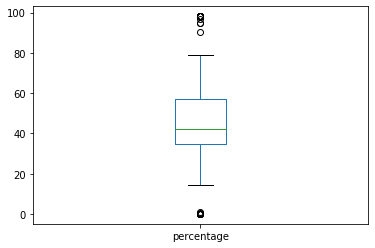

In [39]:
nan_frame['percentage'].plot.box()

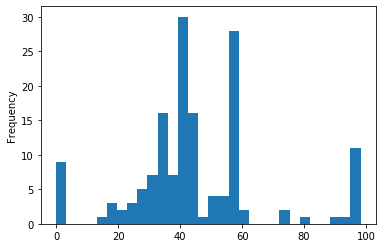

In [49]:
nan_frame['percentage'].plot.hist(bins=30)

In [41]:
nan_frame[nan_frame['percentage'] > 60]

,NaN Count,percentage
YearsCodedJobPast,50418,98.104763
WebDeveloperType,40696,79.187422
MobileDeveloperType,49839,96.978129
NonDeveloperType,46502,90.484900
ExCoderReturn,50469,98.204001
ExCoderNotForMe,50471,98.207892
ExCoderBalance,50469,98.204001
ExCoder10Years,50475,98.215676
ExCoderBelonged,50464,98.194271
ExCoderSkills,50457,98.180651


In [77]:
pd.set_option('display.max_columns', None)
pd.set_option("max_rows", None)
nan_frame

,NaN Count,percentage
Respondent,0,0.000000
Professional,0,0.000000
ProgramHobby,0,0.000000
Country,0,0.000000
University,0,0.000000
EmploymentStatus,0,0.000000
FormalEducation,0,0.000000
MajorUndergrad,8551,16.638776
HomeRemote,7384,14.367995
CompanySize,12470,24.264477


In [139]:
survey['JobSatisfaction'].unique()

array([nan,  9.,  3.,  8.,  6.,  7.,  5.,  4., 10.,  2.,  0.,  1.])

In [137]:
entries - 38501

12891

In [78]:
%matplotlib notebook
# pd.reset_option(“max_columns”)
pd.set_option('display.max_columns', None)
pd.set_option("max_rows", None)
survey[survey['YearsCodedJobPast'].notna()]

,Respondent,Professional,ProgramHobby,Country,University,EmploymentStatus,FormalEducation,MajorUndergrad,HomeRemote,CompanySize,CompanyType,YearsProgram,YearsCodedJob,YearsCodedJobPast,DeveloperType,WebDeveloperType,MobileDeveloperType,NonDeveloperType,CareerSatisfaction,JobSatisfaction,ExCoderReturn,ExCoderNotForMe,ExCoderBalance,ExCoder10Years,ExCoderBelonged,ExCoderSkills,ExCoderWillNotCode,ExCoderActive,PronounceGIF,ProblemSolving,BuildingThings,LearningNewTech,BoringDetails,JobSecurity,DiversityImportant,AnnoyingUI,FriendsDevelopers,RightWrongWay,UnderstandComputers,SeriousWork,InvestTimeTools,WorkPayCare,KinshipDevelopers,ChallengeMyself,CompetePeers,ChangeWorld,JobSeekingStatus,HoursPerWeek,LastNewJob,AssessJobIndustry,AssessJobRole,AssessJobExp,AssessJobDept,AssessJobTech,AssessJobProjects,AssessJobCompensation,AssessJobOffice,AssessJobCommute,AssessJobRemote,AssessJobLeaders,AssessJobProfDevel,AssessJobDiversity,AssessJobProduct,AssessJobFinances,ImportantBenefits,ClickyKeys,JobProfile,ResumePrompted,LearnedHiring,ImportantHiringAlgorithms,ImportantHiringTechExp,ImportantHiringCommunication,ImportantHiringOpenSource,ImportantHiringPMExp,ImportantHiringCompanies,ImportantHiringTitles,ImportantHiringEducation,ImportantHiringRep,ImportantHiringGettingThingsDone,Currency,Overpaid,TabsSpaces,EducationImportant,EducationTypes,SelfTaughtTypes,TimeAfterBootcamp,CousinEducation,WorkStart,HaveWorkedLanguage,WantWorkLanguage,HaveWorkedFramework,WantWorkFramework,HaveWorkedDatabase,WantWorkDatabase,HaveWorkedPlatform,WantWorkPlatform,IDE,AuditoryEnvironment,Methodology,VersionControl,CheckInCode,ShipIt,OtherPeoplesCode,ProjectManagement,EnjoyDebugging,InTheZone,DifficultCommunication,CollaborateRemote,MetricAssess,EquipmentSatisfiedMonitors,EquipmentSatisfiedCPU,EquipmentSatisfiedRAM,EquipmentSatisfiedStorage,EquipmentSatisfiedRW,InfluenceInternet,InfluenceWorkstation,InfluenceHardware,InfluenceServers,InfluenceTechStack,InfluenceDeptTech,InfluenceVizTools,InfluenceDatabase,InfluenceCloud,InfluenceConsultants,InfluenceRecruitment,InfluenceCommunication,StackOverflowDescribes,StackOverflowSatisfaction,StackOverflowDevices,StackOverflowFoundAnswer,StackOverflowCopiedCode,StackOverflowJobListing,StackOverflowCompanyPage,StackOverflowJobSearch,StackOverflowNewQuestion,StackOverflowAnswer,StackOverflowMetaChat,StackOverflowAdsRelevant,StackOverflowAdsDistracting,StackOverflowModeration,StackOverflowCommunity,StackOverflowHelpful,StackOverflowBetter,StackOverflowWhatDo,StackOverflowMakeMoney,Gender,HighestEducationParents,Race,SurveyLong,QuestionsInteresting,QuestionsConfusing,InterestedAnswers,Salary,ExpectedSalary
12,13,Used to be a professional developer,"Yes, I program as a hobby",United Kingdom,No,"Not employed, but looking for work",Bachelor's degree,Mathematics or statistics,NaN,NaN,NaN,20 or more years,NaN,17 to 18 years,NaN,NaN,NaN,NaN,3.0,NaN,Agree,Strongly disagree,Disagree,Strongly disagree,Disagree,Strongly disagree,Disagree,Somewhat agree,"With a hard ""g,"" like ""gift""",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,I am actively looking for a job,1.0,More than 4 years ago,Important,Somewhat important,Important,Important,Very important,Important,Important,Very important,Somewhat important,Not at all important,Not very important,Important,Not very important,Not very important,Somewhat important,Retirement; Vacation/days off; Equipment; Prof...,No,LinkedIn,NaN,NaN,Important,Somewhat important,Not at all important,Not at all important,Not at all important,Not very important,Not at all important,Important,Not very important,Very important,NaN,NaN,Spaces,NaN,NaN,NaN,NaN,NaN,10:00 AM,C; C++; Java,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Turn on some music,NaN,Zip file back-ups,Never,Agree,Agree,Agree,Somewhat agree,Strongly agree,Disagree,Strongly agree,Customer satisfaction; Benchmarked product per...,Very satisfied,Very satisfied,Very satisfied,Very satisfied,Very satisfied,Very satisfied,NaN,NaN,NaN,NaN,NaN,Na

In [79]:
survey['YearsCodedJob'].unique()

array([nan, '20 or more years', '9 to 10 years', '10 to 11 years',
       '8 to 9 years', '7 to 8 years', '11 to 12 years', '15 to 16 years',
       '1 to 2 years', '3 to 4 years', '12 to 13 years',
       'Less than a year', '5 to 6 years', '16 to 17 years',
       '13 to 14 years', '6 to 7 years', '2 to 3 years', '17 to 18 years',
       '4 to 5 years', '14 to 15 years', '18 to 19 years',
       '19 to 20 years'], dtype=object)

In [115]:
import math
# categorysample = '17 to 18 years'
ind = 2
categorysample = survey['YearsCodedJob'].loc[ind]
print(survey['YearsCodedJob'].loc[ind])
if pd.isnull(categorysample):
    x = None
else:
    x = categorysample.split()[0]
# print(categorysample.split())
# print(categorysample.split()[0])
print(x)

20 or more years
20


In [130]:
survey['MinYearsCodedJob'] = survey['YearsCodedJob'].apply(lambda x: x.split()[0] if not pd.isnull(x) else None)
survey['MinYearsCodedJob'] = survey['MinYearsCodedJob'].apply(lambda x: None if x == 'Less' else x)
survey[['MinYearsCodedJob', 'YearsCodedJob']]

,MinYearsCodedJob,YearsCodedJob
0,None,NaN
1,None,NaN
2,20,20 or more years
3,9,9 to 10 years
4,10,10 to 11 years
5,None,NaN
6,8,8 to 9 years
7,7,7 to 8 years
8,7,7 to 8 years
9,8,8 to 9 years


In [136]:
# survey['MinYearsCodedJob'].plot.density()
%matplotlib inline
survey['MinYearsCodedJob'][survey['MinYearsCodedJob'].notna()]
# survey['MinYearsCodedJob'][survey['MinYearsCodedJob'].notna()].plot.hist()

2        20
3         9
4        10
6         8
7         7
8         7
9         8
10       11
11        8
13       15
14       20
15        1
16        8
17       20
18        3
19       12
21       20
22        5
23        7
24        9
25       16
26        9
28       13
29        3
30        5
31        6
33        6
34        1
35        2
36        9
37        7
38       20
39        5
40       20
41       17
44       10
47        2
48        5
49       20
50        1
51        7
52        1
53       20
54        4
55        2
57        4
58       10
59        9
60       20
61        1
62       16
63        2
64        4
65        2
66        8
67       20
68       16
69        4
70        1
71        5
72       20
73       12
74        2
75       16
76       20
77        2
78        1
79       14
80        2
81       13
82       18
85        2
86       10
88        4
89       11
90        3
91       10
92       15
93        3
94        1
95        4
96        1
97        4
99  

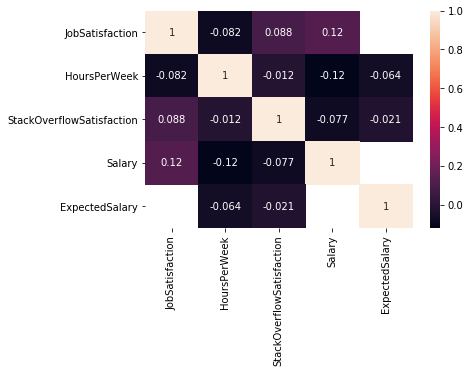

In [148]:
import seaborn as sns
cols = ['JobSatisfaction',
'HoursPerWeek',
'StackOverflowSatisfaction',
'Salary',
'ExpectedSalary']
sns.heatmap(survey[cols].corr(), annot=survey[cols].corr())

In [ ]:
te kolumny nie współgrają ze soba elo

In [18]:
cols = ['JobSatisfaction',
        'Salary',
'HoursPerWeek',
'StackOverflowSatisfaction',
'ExpectedSalary']

In [153]:
survey['HoursPerWeek'].unique()

array([ 0., nan,  5.,  1.,  2.,  3.,  4., 10.,  6.,  7., 40., 21.,  8.,
       30., 19., 20., 12.,  9., 15., 25., 22., 11., 35., 14., 38., 32.,
       34., 16., 24., 13., 37., 18., 26., 39., 23., 28., 27., 17., 29.,
       36., 33., 31.])

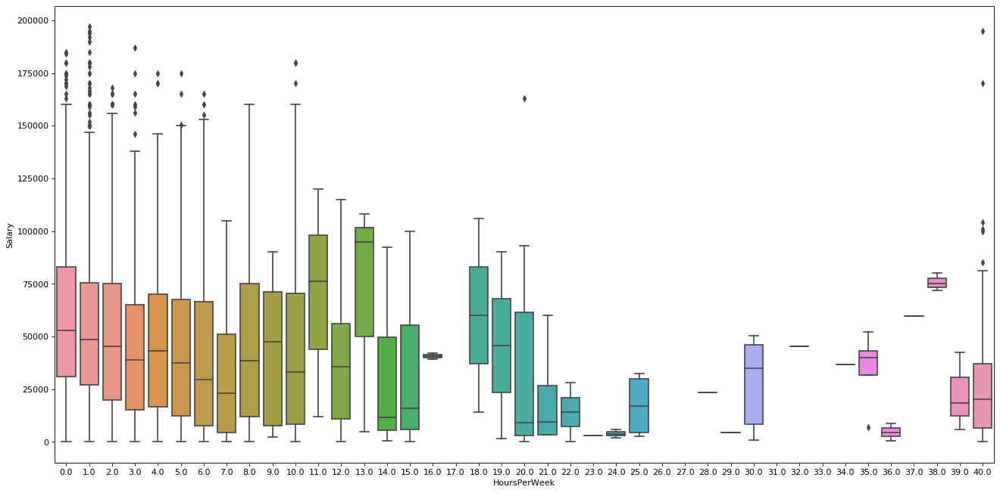

In [159]:
plt.figure(figsize=(20,10), dpi=80)
sns.boxplot(x=survey['HoursPerWeek'], y=survey['Salary'])

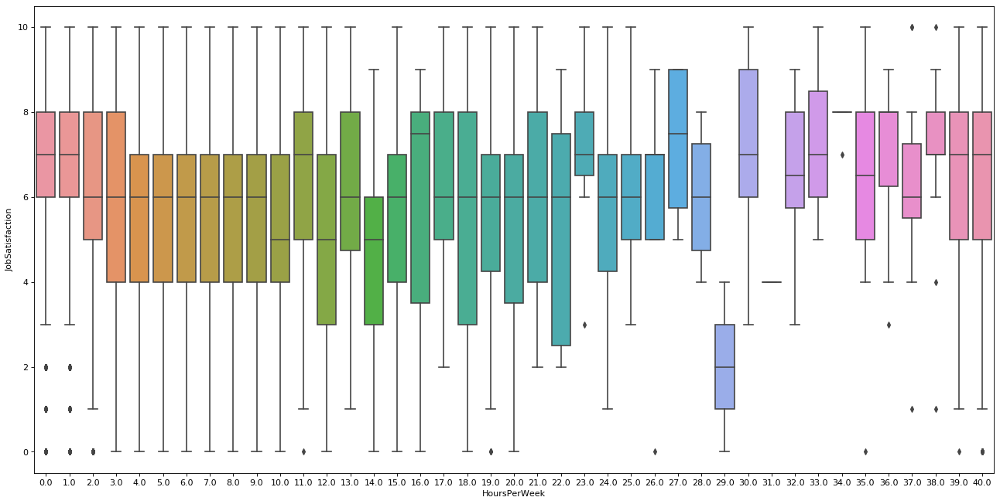

In [160]:
plt.figure(figsize=(20,10), dpi=80)
sns.boxplot(x=survey['HoursPerWeek'], y=survey['JobSatisfaction'])

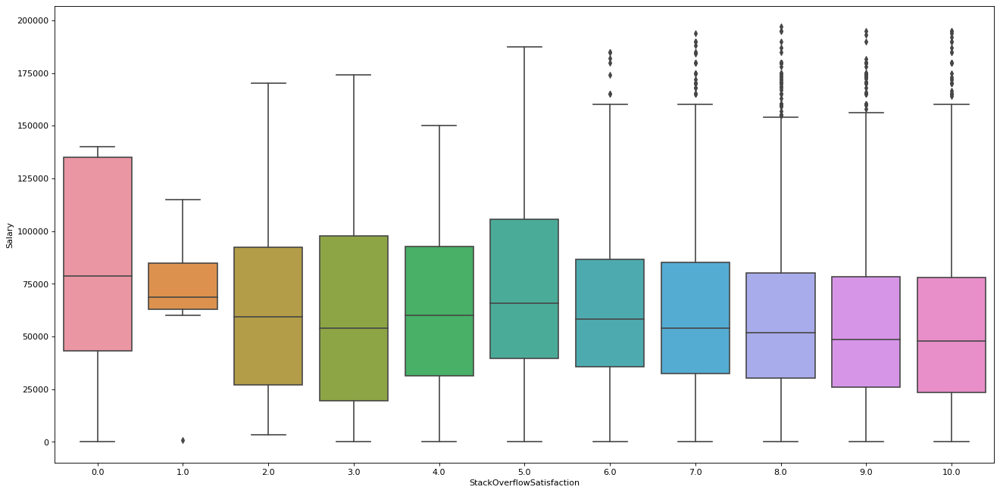

In [165]:
plt.figure(figsize=(20,10), dpi=80)
sns.boxplot(x=survey['StackOverflowSatisfaction'], y=survey['Salary'])

ValueError: could not convert string to float: 'Ideal'

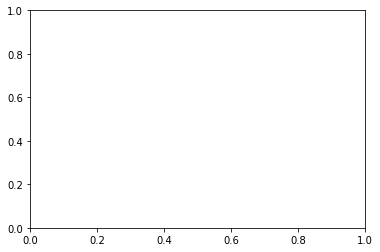

In [24]:
diamonds = sns.load_dataset("diamonds")
sns.kdeplot(data=diamonds, x="price", log_scale=True)

ValueError: could not convert string to float: 'Professional developer'

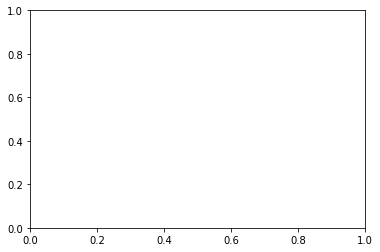

In [23]:
import seaborn as sns

cols = ['JobSatisfaction',
        'Salary',
'HoursPerWeek',
'StackOverflowSatisfaction',
'ExpectedSalary']

df = survey.drop(survey[survey['Salary'].isna()].index)
sns.kdeplot(data=survey.drop(survey[survey['Salary'].isna()].index), x="Salary")